# Imports

In [1]:
import numpy as np
import os
import sys
import pickle
import scipy
import pandas as pd

import matplotlib.pyplot as plt
import networkx as nx
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.cm import ScalarMappable

from pycirclize import Circos
from pycirclize.parser import Matrix

import networkx as nx

## Helper Functions

In [2]:
%store -r analysis_hf
sys.path.insert(0, analysis_hf)

import fixedDensity as fd
import chordPlot as cp

# Set Directory Paths

In [3]:
# Directory path to load formatted Layer Data
%store -r layer_dataDir

# Directory path to save Calcualted Analysis Data
%store -r layer_CalData

# Directory path to save Figures
%store -r layer_Fig

# Loading

## Loading Covariance Matrices

In [4]:
# cov_SMI32_dict
with open(os.path.join(layer_CalData, 'cov_SMI32_dict.pkl'), 'rb') as f:
    cov_SMI32_dict = pickle.load(f)
f.close()

# cov_SMI32_dict_w_agesex
with open(os.path.join(layer_CalData, 'cov_SMI32_dict_w_agesex.pkl'), 'rb') as f:
    cov_SMI32_dict_w_agesex = pickle.load(f)
f.close()

# cov_SMI32_dict_w_agesexNeuNADNC
with open(os.path.join(layer_CalData, 'cov_SMI32_dict_w_agesexNeuNADNC.pkl'), 'rb') as f:
    cov_SMI32_dict_w_agesexNeuNADNC = pickle.load(f)
f.close()

## Loading Log %AO Values

In [5]:
# NeuN_HC
with open(os.path.join(layer_dataDir, 'NeuN_HC.pkl'), 'rb') as f:
    NeuN_HC = pickle.load(f)
f.close()

# NeuN_TAU
with open(os.path.join(layer_dataDir, 'NeuN_TAU.pkl'), 'rb') as f:
    NeuN_TAU = pickle.load(f)
f.close()

# NeuN_TDP
with open(os.path.join(layer_dataDir, 'NeuN_TDP.pkl'), 'rb') as f:
    NeuN_TDP = pickle.load(f)
f.close()

# SMI32_HC
with open(os.path.join(layer_dataDir, 'SMI32_HC.pkl'), 'rb') as f:
    SMI32_HC = pickle.load(f)
f.close()

# SMI32_TAU
with open(os.path.join(layer_dataDir, 'SMI32_TAU.pkl'), 'rb') as f:
    SMI32_TAU = pickle.load(f)
f.close()

# SMI32_TDP
with open(os.path.join(layer_dataDir, 'SMI32_TDP.pkl'), 'rb') as f:
    SMI32_TDP = pickle.load(f)
f.close()

## Loading Layer Neuron Labels (SMI32)

In [6]:
SMI32_Labels = ['L23_1(Cingulate)', 'L23_2(Cingulate)', 'L23_3d(Paracingulate)', 'L23_3v(Paracingulate)', 'L23_4(Rectus)', 'L23_5(Middle Frontal)', 
               'L56_1(Cingulate)', 'L56_2(Cingulate)', 'L56_3d(Paracingulate)', 'L56_3v(Paracingulate)', 'L56_4(Rectus)', 'L56_5(Middle Frontal)']

# Sub-Track Condition

## Define Variables

### Set fixed density value 

In [7]:
fd_val = 10

### Label Order

In [8]:
order = ['L23_5(Middle Frontal)',
         'L23_4(Rectus)',
         'L23_3v(Paracingulate)', 
         'L23_3d(Paracingulate)',
         'L23_2(Cingulate)',
         'L23_1(Cingulate)',
         'L56_1(Cingulate)',
         'L56_2(Cingulate)',
         'L56_3d(Paracingulate)',
         'L56_3v(Paracingulate)', 
         'L56_4(Rectus)',
         'L56_5(Middle Frontal)']

# Draw Graph Networks (SMI32)

### Dataset to Use

In [9]:
# Variable setting
neuron_type = "SMI32"
val_type = 'Original'
cov_dict = cov_SMI32_dict
data_label = SMI32_Labels

In [10]:
# Set Node Sizes based on Log %AO values
HC_exp = SMI32_HC.copy()
TAU_exp = SMI32_TAU.copy()
TDP_exp = SMI32_TDP.copy()

# Get min/max %AO of LBD
minVal = np.nanmin(np.concatenate((HC_exp.flatten(), TAU_exp.flatten(), TDP_exp.flatten())))
maxVal = np.nanmax(np.concatenate((HC_exp.flatten(), TAU_exp.flatten(), TDP_exp.flatten())) - minVal + 0.0015, axis=0)

scale = 700

# Apply a transformation to create a more dramatic difference in node sizes
def transform_values(values, min_val, max_val, scale):
    # Normalize the values
    normalized = (values - min_val) / max_val
    # Apply an exponential transformation
    transformed = np.exp(normalized)**3 - 1  # subtracting 1 to bring the minimum back to 0
    # Scale the transformed values
    return scale * transformed

# Size of Nodes
markerVecHC = np.nanmean(HC_exp, axis=0)
markerVecHC = transform_values(markerVecHC, minVal, maxVal, scale)

markerVecTAU = np.nanmean(TAU_exp, axis=0)
markerVecTAU = transform_values(markerVecTAU, minVal, maxVal, scale)

markerVecTDP = np.nanmean(TDP_exp, axis=0)
markerVecTDP = transform_values(markerVecTDP, minVal, maxVal, scale)

## HC > TAU

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

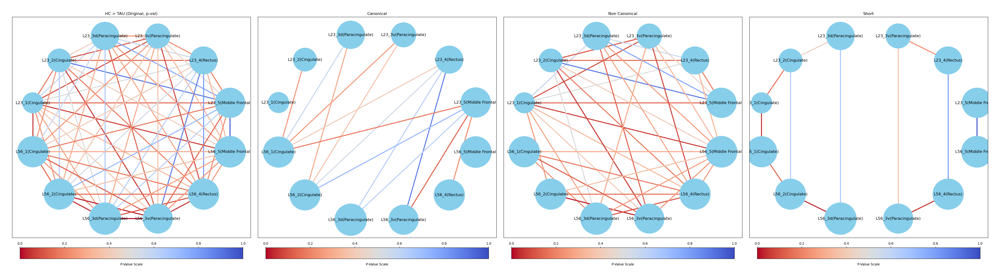

In [11]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, f'HC > TAU ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecHC)

plt.savefig(layer_Fig + f'/SMI32_HC > TAU ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()



## TAU > HC

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

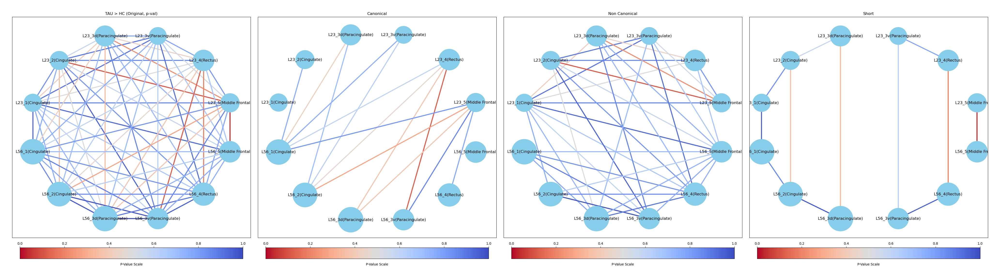

In [12]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, f'TAU > HC ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTAU)

plt.savefig(layer_Fig + f'/SMI32_TAU > HC ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## HC > TDP

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

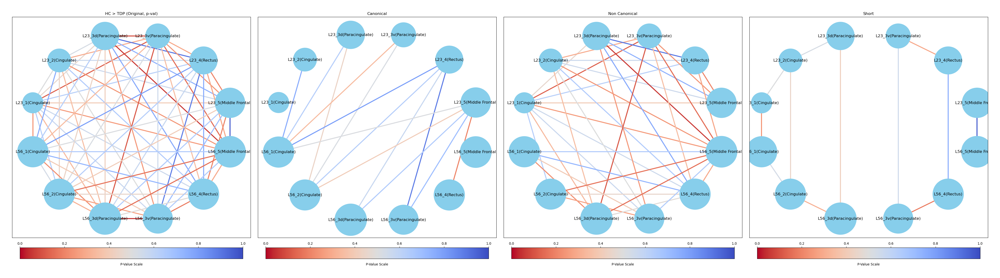

In [13]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, f'HC > TDP ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecHC)

plt.savefig(layer_Fig + f'/SMI32_HC > TDP ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TDP > HC

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

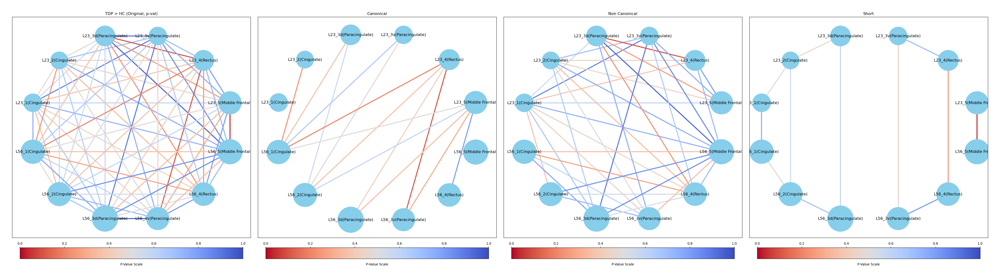

In [14]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, f'TDP > HC ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTDP)

plt.savefig(layer_Fig + f'/SMI32_TDP > HC ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TAU > TDP

In [15]:
pd.DataFrame(cov_dict['TAU_gt_TDP_raw'])

,0,1,2,3,4,5,6,7,8,9,10,11
0,NaN,0.853768,0.372332,0.636323,0.618678,0.848948,0.865826,0.859102,0.597881,0.654682,0.729585,0.856283
1,0.853768,NaN,0.608234,0.794621,0.908691,0.090921,0.924304,0.289370,0.363495,0.939885,0.916230,0.312871
2,0.372332,0.608234,NaN,0.339837,0.866331,0.421266,0.549440,0.668066,0.250824,0.699008,0.919656,0.149224
3,0.636323,0.794621,0.339837,NaN,0.628228,0.309235,0.631287,0.639795,0.303003,0.676724,0.856384,0.321918
4,0.618678,0.908691,0.866331,0.628228,NaN,0.568498,0.860861,0.581420,0.446648,0.435802,0.381606,0.466113
5,0.848948,0.090921,0.421266,0.309235,0.568498,NaN,0.864649,0.171754,0.525161,0.947148,0.494073,0.397201
6,0.865826,0.924304,0.549440,0.631287,0.860861,0.864649,NaN,0.886525,0.518918,0.829530,0.948711,0.856348
7,0.859102,0.289370,0.668066,0.639795,0.581420,0.171754,0.886525,NaN,0.934237,0.938202,0.843500,0.261246
8,0.597881,0.363495,0.250824,0.303003,0.446648,0.525161,0.518918,0.934237,NaN,0.816260,0.914247,0.346798
9,0.654682,0.939885,0.699008,0.676724,0.435802,0.947148,0.829530,0.938202,0.816260,NaN,0.810211,0.854135


<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

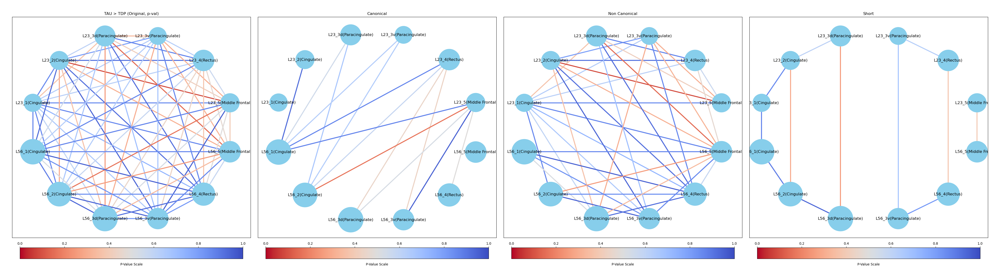

In [16]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, f'TAU > TDP ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTAU)

plt.savefig(layer_Fig + f'/SMI32_TAU > TDP ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TDP > TAU

In [17]:
pd.DataFrame(cov_dict['TDP_gt_TAU_raw'], index=data_label, columns=data_label)

,L23_1(Cingulate),L23_2(Cingulate),L23_3d(Paracingulate),L23_3v(Paracingulate),L23_4(Rectus),L23_5(Middle Frontal),L56_1(Cingulate),L56_2(Cingulate),L56_3d(Paracingulate),L56_3v(Paracingulate),L56_4(Rectus),L56_5(Middle Frontal)
L23_1(Cingulate),NaN,0.146232,0.627668,0.363677,0.381322,0.151052,0.134174,0.140898,0.402119,0.345318,0.270415,0.143717
L23_2(Cingulate),0.146232,NaN,0.391766,0.205379,0.091309,0.909079,0.075696,0.710630,0.636505,0.060115,0.083770,0.687129
L23_3d(Paracingulate),0.627668,0.391766,NaN,0.660163,0.133669,0.578734,0.450560,0.331934,0.749176,0.300992,0.080344,0.850776
L23_3v(Paracingulate),0.363677,0.205379,0.660163,NaN,0.371772,0.690765,0.368713,0.360205,0.696997,0.323276,0.143616,0.678082
L23_4(Rectus),0.381322,0.091309,0.133669,0.371772,NaN,0.431502,0.139139,0.418580,0.553352,0.564198,0.618394,0.533887
L23_5(Middle Frontal),0.151052,0.909079,0.578734,0.690765,0.431502,NaN,0.135351,0.828246,0.474839,0.052852,0.505927,0.602799
L56_1(Cingulate),0.134174,0.075696,0.450560,0.368713,0.139139,0.135351,NaN,0.113475,0.481082,0.170470,0.051289,0.143652
L56_2(Cingulate),0.140898,0.710630,0.331934,0.360205,0.418580,0.828246,0.113475,NaN,0.065763,0.061798,0.156500,0.738754
L56_3d(Paracingulate),0.402119,0.636505,0.749176,0.696997,0.553352,0.474839,0.481082,0.065763,NaN,0.183740,0.085753,0.653202
L56_3v(Paracingulate),0.345318,0.060115,0.300992,0.323276,0.564198,0.052852,0.170470,0.061798,0.183740,NaN,0.189789,0.145865


<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

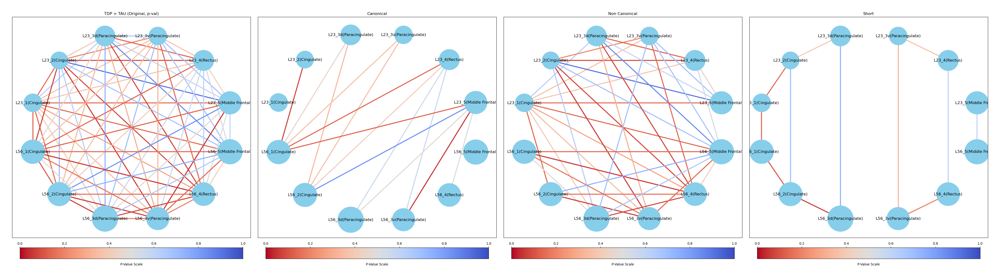

In [18]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, f'TDP > TAU ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTDP)

plt.savefig(layer_Fig + f'/SMI32_TDP > TAU ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

# Draw Graph Networks (SMI32) - W_Score (Age, Sex)

### Dataset to Use

In [19]:
# Variable setting
neuron_type = "SMI32"
val_type = 'W-Score(Age,Sex)'
cov_dict = cov_SMI32_dict_w_agesex
data_label = SMI32_Labels

In [20]:
# Set Node Sizes based on Log %AO values
HC_exp = SMI32_HC.copy()
TAU_exp = SMI32_TAU.copy()
TDP_exp = SMI32_TDP.copy()

# Get min/max %AO of LBD
minVal = np.nanmin(np.concatenate((HC_exp.flatten(), TAU_exp.flatten(), TDP_exp.flatten())))
maxVal = np.nanmax(np.concatenate((HC_exp.flatten(), TAU_exp.flatten(), TDP_exp.flatten())) - minVal + 0.0015, axis=0)

scale = 700

# Apply a transformation to create a more dramatic difference in node sizes
def transform_values(values, min_val, max_val, scale):
    # Normalize the values
    normalized = (values - min_val) / max_val
    # Apply an exponential transformation
    transformed = np.exp(normalized) - 1  # subtracting 1 to bring the minimum back to 0
    # Scale the transformed values
    return scale * transformed

# Size of Nodes
markerVecHC = np.nanmean(HC_exp, axis=0)
markerVecHC = transform_values(markerVecHC, minVal, maxVal, scale)

markerVecTAU = np.nanmean(TAU_exp, axis=0)
markerVecTAU = transform_values(markerVecTAU, minVal, maxVal, scale)

markerVecTDP = np.nanmean(TDP_exp, axis=0)
markerVecTDP = transform_values(markerVecTDP, minVal, maxVal, scale)

## HC > TAU

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

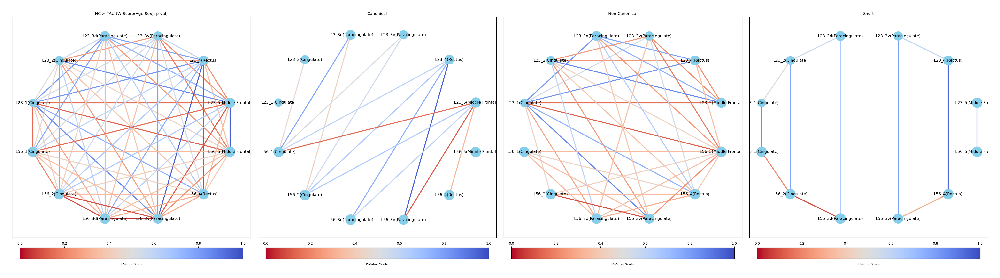

In [21]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, f'HC > TAU ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecHC)

plt.savefig(layer_Fig + f'/SMI32_HC > TAU ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()



## TAU > HC

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

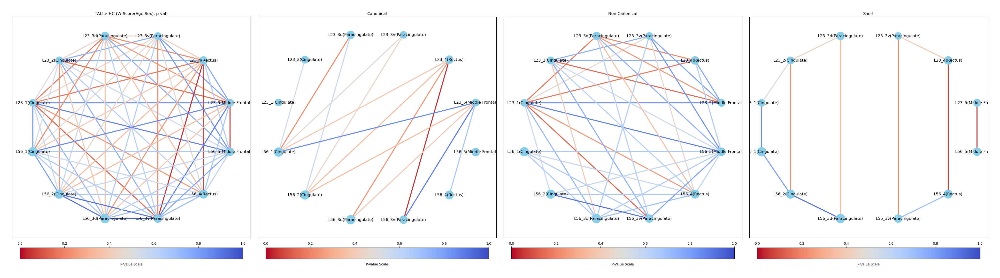

In [22]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, f'TAU > HC ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTAU)

plt.savefig(layer_Fig + f'/SMI32_TAU > HC ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## HC > TDP

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

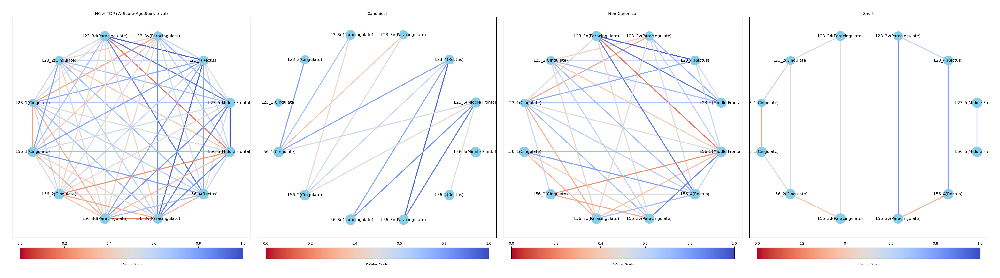

In [23]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, f'HC > TDP ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecHC)

plt.savefig(layer_Fig + f'/SMI32_HC > TDP ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TDP > HC

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

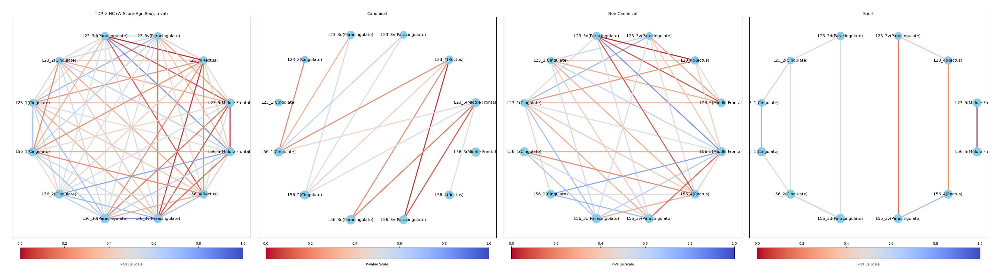

In [24]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, f'TDP > HC ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTDP)

plt.savefig(layer_Fig + f'/SMI32_TDP > HC ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TAU > TDP

In [25]:
pd.DataFrame(cov_dict['TAU_gt_TDP_raw'])

,0,1,2,3,4,5,6,7,8,9,10,11
0,NaN,0.599442,0.177793,0.275824,0.378251,0.949985,0.704413,0.639782,0.549862,0.265785,0.335864,0.909227
1,0.599442,NaN,0.493955,0.699264,0.840237,0.238461,0.807334,0.192213,0.327799,0.820624,0.812331,0.457215
2,0.177793,0.493955,NaN,0.399654,0.846007,0.744415,0.357372,0.533857,0.312731,0.585450,0.804697,0.370363
3,0.275824,0.699264,0.399654,NaN,0.499732,0.914569,0.385359,0.466512,0.613372,0.513269,0.491233,0.898724
4,0.378251,0.840237,0.846007,0.499732,NaN,0.851472,0.675506,0.406372,0.499820,0.353141,0.191647,0.749100
5,0.949985,0.238461,0.744415,0.914569,0.851472,NaN,0.911051,0.282026,0.783793,0.991580,0.706946,0.642070
6,0.704413,0.807334,0.357372,0.385359,0.675506,0.911051,NaN,0.837601,0.490907,0.603319,0.847980,0.861765
7,0.639782,0.192213,0.533857,0.466512,0.406372,0.282026,0.837601,NaN,0.878856,0.805188,0.678302,0.278715
8,0.549862,0.327799,0.312731,0.613372,0.499820,0.783793,0.490907,0.878856,NaN,0.846761,0.867231,0.496774
9,0.265785,0.820624,0.585450,0.513269,0.353141,0.991580,0.603319,0.805188,0.846761,NaN,0.544689,0.961983


<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

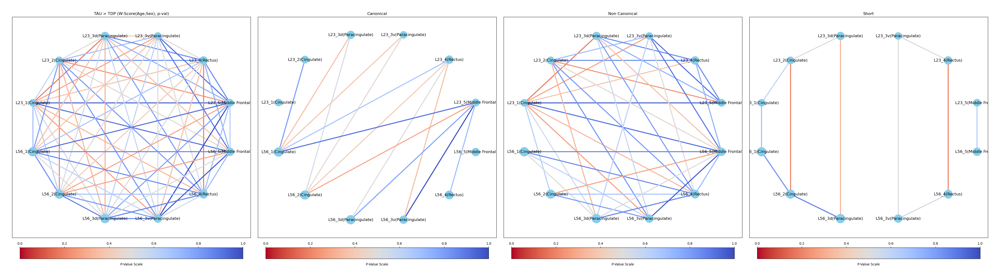

In [26]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, f'TAU > TDP ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTAU)

plt.savefig(layer_Fig + f'/SMI32_TAU > TDP ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TDP > TAU

In [27]:
pd.DataFrame(cov_dict['TDP_gt_TAU_raw'], index=data_label, columns=data_label)

,L23_1(Cingulate),L23_2(Cingulate),L23_3d(Paracingulate),L23_3v(Paracingulate),L23_4(Rectus),L23_5(Middle Frontal),L56_1(Cingulate),L56_2(Cingulate),L56_3d(Paracingulate),L56_3v(Paracingulate),L56_4(Rectus),L56_5(Middle Frontal)
L23_1(Cingulate),NaN,0.400558,0.822207,0.724176,0.621749,0.050015,0.295587,0.360218,0.450138,0.734215,0.664136,0.090773
L23_2(Cingulate),0.400558,NaN,0.506045,0.300736,0.159763,0.761539,0.192666,0.807787,0.672201,0.179376,0.187669,0.542785
L23_3d(Paracingulate),0.822207,0.506045,NaN,0.600346,0.153993,0.255585,0.642628,0.466143,0.687269,0.414550,0.195303,0.629637
L23_3v(Paracingulate),0.724176,0.300736,0.600346,NaN,0.500268,0.085431,0.614641,0.533488,0.386628,0.486731,0.508767,0.101276
L23_4(Rectus),0.621749,0.159763,0.153993,0.500268,NaN,0.148528,0.324494,0.593628,0.500180,0.646859,0.808353,0.250900
L23_5(Middle Frontal),0.050015,0.761539,0.255585,0.085431,0.148528,NaN,0.088949,0.717974,0.216207,0.008420,0.293054,0.357930
L56_1(Cingulate),0.295587,0.192666,0.642628,0.614641,0.324494,0.088949,NaN,0.162399,0.509093,0.396681,0.152020,0.138235
L56_2(Cingulate),0.360218,0.807787,0.466143,0.533488,0.593628,0.717974,0.162399,NaN,0.121144,0.194812,0.321698,0.721285
L56_3d(Paracingulate),0.450138,0.672201,0.687269,0.386628,0.500180,0.216207,0.509093,0.121144,NaN,0.153239,0.132769,0.503226
L56_3v(Paracingulate),0.734215,0.179376,0.414550,0.486731,0.646859,0.008420,0.396681,0.194812,0.153239,NaN,0.455311,0.038017


<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

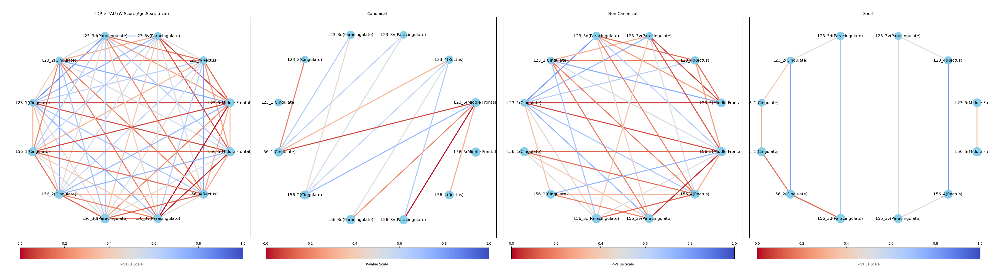

In [28]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, f'TDP > TAU ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTDP)

plt.savefig(layer_Fig + f'/SMI32_TDP > TAU ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

# Draw Graph Networks (SMI32) - W_Score (Age, Sex, NeuN, ADNC)

### Dataset to Use

In [29]:
# Variable setting
neuron_type = "SMI32"
val_type = 'W-Score(Age,Sex,NeuN,ADNC)'
cov_dict = cov_SMI32_dict_w_agesexNeuNADNC
data_label = SMI32_Labels

In [30]:
# Set Node Sizes based on Log %AO values
HC_exp = SMI32_HC.copy()
TAU_exp = SMI32_TAU.copy()
TDP_exp = SMI32_TDP.copy()

# Get min/max %AO of LBD
minVal = np.nanmin(np.concatenate((HC_exp.flatten(), TAU_exp.flatten(), TDP_exp.flatten())))
maxVal = np.nanmax(np.concatenate((HC_exp.flatten(), TAU_exp.flatten(), TDP_exp.flatten())) - minVal + 0.0015, axis=0)

scale = 700

# Apply a transformation to create a more dramatic difference in node sizes
def transform_values(values, min_val, max_val, scale):
    # Normalize the values
    normalized = (values - min_val) / max_val
    # Apply an exponential transformation
    transformed = np.exp(normalized) - 1  # subtracting 1 to bring the minimum back to 0
    # Scale the transformed values
    return scale * transformed

# Size of Nodes
markerVecHC = np.nanmean(HC_exp, axis=0)
markerVecHC = transform_values(markerVecHC, minVal, maxVal, scale)

markerVecTAU = np.nanmean(TAU_exp, axis=0)
markerVecTAU = transform_values(markerVecTAU, minVal, maxVal, scale)

markerVecTDP = np.nanmean(TDP_exp, axis=0)
markerVecTDP = transform_values(markerVecTDP, minVal, maxVal, scale)

## HC > TAU

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

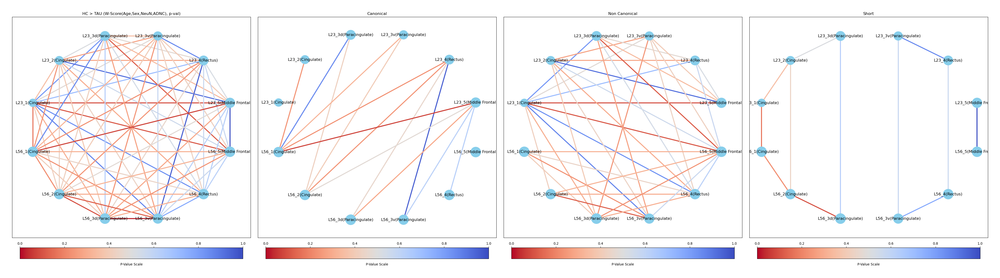

In [31]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, f'HC > TAU ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TAU_lt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecHC)

plt.savefig(layer_Fig + f'/SMI32_HC > TAU ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()



## TAU > HC

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

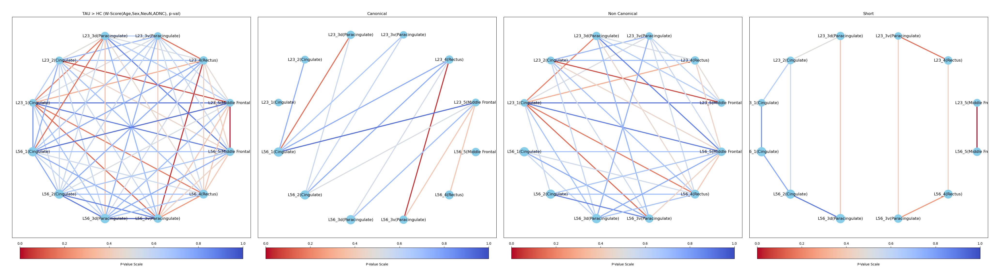

In [32]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, f'TAU > HC ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTAU)

plt.savefig(layer_Fig + f'/SMI32_TAU > HC ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## HC > TDP

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

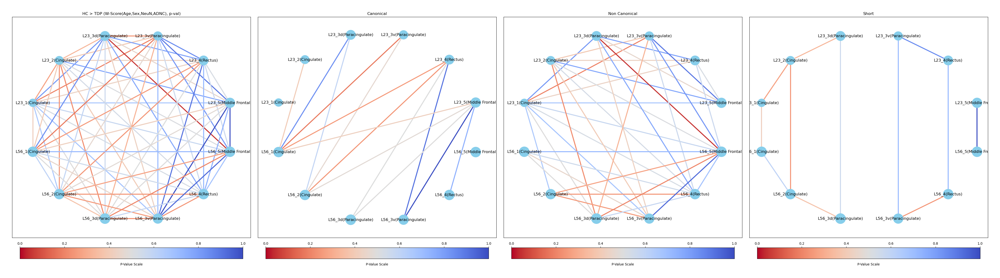

In [33]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, f'HC > TDP ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecHC)
cp.chordPlotRaw(cov_dict['TDP_lt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecHC)

plt.savefig(layer_Fig + f'/SMI32_HC > TDP ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TDP > HC

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

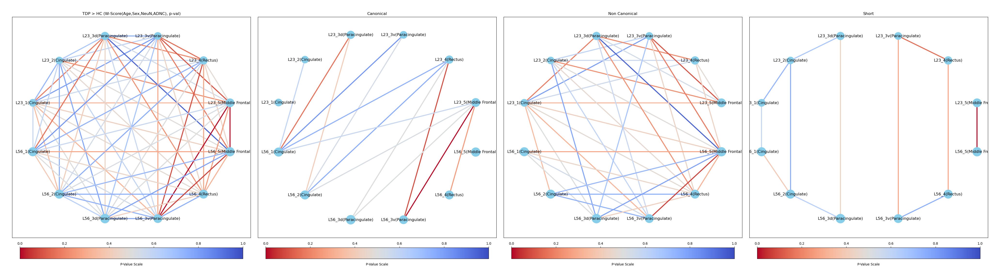

In [34]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, f'TDP > HC ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_HC_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTDP)

plt.savefig(layer_Fig + f'/SMI32_TDP > HC ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TAU > TDP

In [35]:
pd.DataFrame(cov_dict['TAU_gt_TDP_raw'])

,0,1,2,3,4,5,6,7,8,9,10,11
0,NaN,0.429788,0.459787,0.250865,0.229743,0.977999,0.806217,0.723822,0.711038,0.230006,0.154515,0.950638
1,0.429788,NaN,0.329166,0.650919,0.679823,0.187289,0.708806,0.313902,0.321462,0.485581,0.748881,0.440141
2,0.459787,0.329166,NaN,0.402167,0.806225,0.652792,0.439096,0.668128,0.414915,0.674720,0.741151,0.327363
3,0.250865,0.650919,0.402167,NaN,0.418106,0.921746,0.370875,0.567822,0.623437,0.600650,0.614618,0.848802
4,0.229743,0.679823,0.806225,0.418106,NaN,0.496023,0.564023,0.549582,0.552352,0.279596,0.640720,0.485111
5,0.977999,0.187289,0.652792,0.921746,0.496023,NaN,0.929076,0.505421,0.761570,0.968463,0.625137,0.374947
6,0.806217,0.708806,0.439096,0.370875,0.564023,0.929076,NaN,0.860637,0.601110,0.742108,0.615581,0.882913
7,0.723822,0.313902,0.668128,0.567822,0.549582,0.505421,0.860637,NaN,0.863477,0.728002,0.466379,0.466972
8,0.711038,0.321462,0.414915,0.623437,0.552352,0.761570,0.601110,0.863477,NaN,0.899736,0.774810,0.471708
9,0.230006,0.485581,0.674720,0.600650,0.279596,0.968463,0.742108,0.728002,0.899736,NaN,0.104480,0.871509


<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

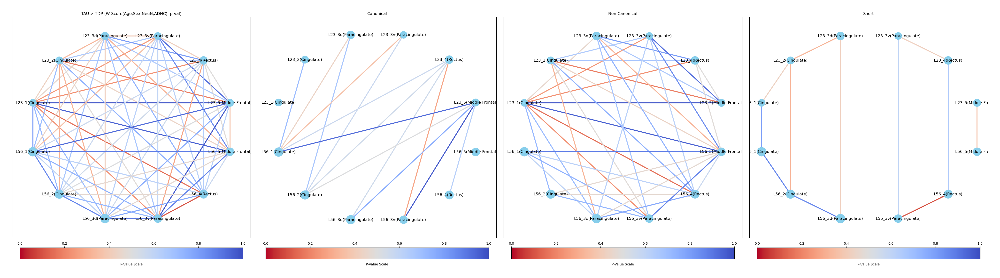

In [36]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, f'TAU > TDP ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTAU)
cp.chordPlotRaw(cov_dict['TAU_gt_TDP_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTAU)

plt.savefig(layer_Fig + f'/SMI32_TAU > TDP ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()

## TDP > TAU

In [37]:
pd.DataFrame(cov_dict['TDP_gt_TAU_raw'], index=data_label, columns=data_label)

,L23_1(Cingulate),L23_2(Cingulate),L23_3d(Paracingulate),L23_3v(Paracingulate),L23_4(Rectus),L23_5(Middle Frontal),L56_1(Cingulate),L56_2(Cingulate),L56_3d(Paracingulate),L56_3v(Paracingulate),L56_4(Rectus),L56_5(Middle Frontal)
L23_1(Cingulate),NaN,0.570212,0.540213,0.749135,0.770257,0.022001,0.193783,0.276178,0.288962,0.769994,0.845485,0.049362
L23_2(Cingulate),0.570212,NaN,0.670834,0.349081,0.320177,0.812711,0.291194,0.686098,0.678538,0.514419,0.251119,0.559859
L23_3d(Paracingulate),0.540213,0.670834,NaN,0.597833,0.193775,0.347208,0.560904,0.331872,0.585085,0.325280,0.258849,0.672637
L23_3v(Paracingulate),0.749135,0.349081,0.597833,NaN,0.581894,0.078254,0.629125,0.432178,0.376563,0.399350,0.385382,0.151198
L23_4(Rectus),0.770257,0.320177,0.193775,0.581894,NaN,0.503977,0.435977,0.450418,0.447648,0.720404,0.359280,0.514889
L23_5(Middle Frontal),0.022001,0.812711,0.347208,0.078254,0.503977,NaN,0.070924,0.494579,0.238430,0.031537,0.374863,0.625053
L56_1(Cingulate),0.193783,0.291194,0.560904,0.629125,0.435977,0.070924,NaN,0.139363,0.398890,0.257892,0.384419,0.117087
L56_2(Cingulate),0.276178,0.686098,0.331872,0.432178,0.450418,0.494579,0.139363,NaN,0.136523,0.271998,0.533621,0.533028
L56_3d(Paracingulate),0.288962,0.678538,0.585085,0.376563,0.447648,0.238430,0.398890,0.136523,NaN,0.100264,0.225190,0.528292
L56_3v(Paracingulate),0.769994,0.514419,0.325280,0.399350,0.720404,0.031537,0.257892,0.271998,0.100264,NaN,0.895520,0.128491


<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

<Figure size 1300x1300 with 0 Axes>

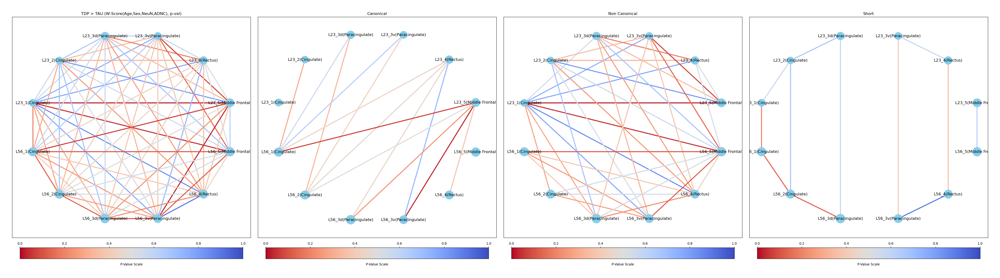

In [38]:
# Create a new figure with a single row and four columns
fig, axs = plt.subplots(1, 4, figsize=(52, 13))  # Adjust the figsize as needed

# Reduce the space between subplots
fig.subplots_adjust(wspace=0.03)  

# Draw each plot in its respective subplot
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, f'TDP > TAU ({val_type}, p-val)', 'cmp', ax=axs[0], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Canonical', 'cmp', sub_path=True, sub_path_type='canonical', ax=axs[1], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Non Canonical', 'cmp', sub_path=True, sub_path_type='noncanonical', ax=axs[2], markerVec=markerVecTDP)
cp.chordPlotRaw(cov_dict['TDP_gt_TAU_raw'], data_label, 'Short', 'cmp', sub_path=True, sub_path_type='short', ax=axs[3], markerVec=markerVecTDP)

plt.savefig(layer_Fig + f'/SMI32_TDP > TAU ({val_type}, p-val).png')

# Show or save the final concatenated figure
plt.show()